In [ ]:
import torch, torchvision, pdb
from torch import nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import numpy as np
import matplotlib.pyplot as plt
import os

In [ ]:
from math import sqrt
def show(tensor, num= 16, wandb= 0, name= ''):
    data = tensor.detach().cpu()
    grid = make_grid(data[: num], nrow= int(num // sqrt(num))).permute(1, 2, 0)

    # if wandb == 1 and wandbact == 1:
    #     wandb.log(name)

    plt.imshow(grid.clip(0, 1)) # Values of pixels should be between 0 and 1
    plt.show()


In [ ]:
try:
    from torchinfo import summary
except:
    ! pip install torchinfo
    from torchinfo import summary

In [ ]:
epochs = 10
BATCH_SIZE = 64
LR = 0.0001
z_dim = 192
device = 'cuda' if torch.cuda.is_available() else 'cpu'
crit_cycle = 5
gen_losses, crit_losses = [], []
save_step = 35
device

'cuda'

In [ ]:
def gen_noise(batch_size= BATCH_SIZE, z_dim= z_dim):
    return torch.randn(batch_size, z_dim).to(device)

## Generator Class
* Initial noise vector is converted into a 4D array -> (BATCH_SIZE, latent_dim, 1, 1)
* Start with a 1 x 1 image with z_dim (also called latent_dim) number of channels
* Apply as series of ConvTranspose2d followed by Batch Norm and ReLU
* This increases the size of the image while decreasing the number of channels
* The last block doesn't have a batch norm
* The output shape corresponds to (color_channels, height, width) of your image data

In [ ]:
def generator_block(input_shape, output_shape, stride= 1, padding= 0):
    return nn.Sequential(
        nn.ConvTranspose2d(in_channels= input_shape, out_channels= output_shape, kernel_size= 4, stride= stride, padding= padding),
        nn.BatchNorm2d(num_features= output_shape),
        nn.ReLU()
    )

In [ ]:
# Generator model
class Generator(nn.Module):
    def __init__(self, z_dim, d_dim, batch_size):
        super().__init__()
        self.batch_size = batch_size
        self.z_dim = z_dim
        self.gen = nn.Sequential(
            # New width = (n-1) * stride - 2 * padding + ks

            # We begin with a 1 x 1 image with z_dim number of channels
            generator_block(z_dim, d_dim),
            generator_block(d_dim, d_dim // 2, stride= 2, padding= 1),
            generator_block(d_dim // 2, d_dim // 4, stride= 2, padding= 1),
            generator_block(d_dim // 4, d_dim // 8, stride= 2, padding= 1),
            generator_block(d_dim // 8, d_dim // 16, stride= 2, padding= 1),

            # The last block will have the dimensions of the output image -> (3, 128, 128)
            # No BatchNorm in the last block
            nn.ConvTranspose2d(in_channels= d_dim // 16, out_channels= 3, kernel_size= 4, stride= 2, padding= 1),
            nn.Tanh()
        )

    def forward(self, x):
        x = x.view(self.batch_size, z_dim, 1, 1)
        return self.gen(x)

In [ ]:
generator = Generator(z_dim= z_dim, d_dim= 512, batch_size= BATCH_SIZE)
summary(generator, (BATCH_SIZE, z_dim), col_names= ["input_size", "output_size", "num_params", "trainable"], col_width= 20)

Layer (type:depth-idx)                   Input Shape          Output Shape         Param #              Trainable
Generator                                [64, 192]            [64, 3, 128, 128]    --                   True
├─Sequential: 1-1                        [64, 192, 1, 1]      [64, 3, 128, 128]    --                   True
│    └─Sequential: 2-1                   [64, 192, 1, 1]      [64, 512, 4, 4]      --                   True
│    │    └─ConvTranspose2d: 3-1         [64, 192, 1, 1]      [64, 512, 4, 4]      1,573,376            True
│    │    └─BatchNorm2d: 3-2             [64, 512, 4, 4]      [64, 512, 4, 4]      1,024                True
│    │    └─ReLU: 3-3                    [64, 512, 4, 4]      [64, 512, 4, 4]      --                   --
│    └─Sequential: 2-2                   [64, 512, 4, 4]      [64, 256, 8, 8]      --                   True
│    │    └─ConvTranspose2d: 3-4         [64, 512, 4, 4]      [64, 256, 8, 8]      2,097,408            True
│    │    └─Batc

## Critic class
* We start with the image as the input to critic -> (batch_size, color_channels, height, width)
* Then we apply Conv2d to reduce the image height and width while increasing the color_channels
* We use **Instance Normalisation** here
    * It normalizes each feature map individually
    * This helps in ditinguishing between real and fake images without introducing batch related statistics
* The output value is only 1 number ( -1 or 1 ) per batch
```
Output shape = [BATCH_SIZE, 1]
```






In [ ]:
def critic_block(input_shape, output_shape, kernel_size= 4, stride= 2, padding= 1):
    return nn.Sequential(
        nn.Conv2d(in_channels= input_shape, out_channels= output_shape, kernel_size= kernel_size, stride= stride, padding= padding),
        nn.InstanceNorm2d(num_features= output_shape),
        nn.LeakyReLU(negative_slope= 0.2)
    )

In [ ]:
class Critic(nn.Module):
    def __init__(self, input_shape, hidden_units, batch_size= BATCH_SIZE):
        super().__init__()
        self.batch_size = batch_size

        # New width = [[n + [2 * padding] - kernel_size] // stride] + 1
        self.critic_main = nn.Sequential(
                critic_block(input_shape, hidden_units),
                critic_block(hidden_units, hidden_units * 2),
                critic_block(hidden_units * 2, hidden_units * 4),
                critic_block(hidden_units * 4, hidden_units * 8),
                critic_block(hidden_units * 8, hidden_units * 16),
            )

        self.output_layer = nn.Sequential(
            nn.Conv2d(in_channels= hidden_units * 16, out_channels= 1, # Critic needs to output 1 value
                      kernel_size= 4, stride= 1, padding= 0),
        )

    def forward(self, x):
        return self.output_layer(self.critic_main(x)).view(self.batch_size, -1)

In [ ]:
critic = Critic(3, hidden_units= 16)
summary(critic, (BATCH_SIZE, 3, 128, 128), col_names= ["input_size", "output_size", "num_params", "trainable"], col_width= 20)

Layer (type:depth-idx)                   Input Shape          Output Shape         Param #              Trainable
Critic                                   [64, 3, 128, 128]    [64, 1]              --                   True
├─Sequential: 1-1                        [64, 3, 128, 128]    [64, 256, 4, 4]      --                   True
│    └─Sequential: 2-1                   [64, 3, 128, 128]    [64, 16, 64, 64]     --                   True
│    │    └─Conv2d: 3-1                  [64, 3, 128, 128]    [64, 16, 64, 64]     784                  True
│    │    └─InstanceNorm2d: 3-2          [64, 16, 64, 64]     [64, 16, 64, 64]     --                   --
│    │    └─LeakyReLU: 3-3               [64, 16, 64, 64]     [64, 16, 64, 64]     --                   --
│    └─Sequential: 2-2                   [64, 16, 64, 64]     [64, 32, 32, 32]     --                   True
│    │    └─Conv2d: 3-4                  [64, 16, 64, 64]     [64, 32, 32, 32]     8,224                True
│    │    └─Instan

## Loading the dataset

In [ ]:
! pip install -q kaggle

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"daimonking5","key":"05b335344470461d6de77565253819ac"}'}

In [ ]:
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
! kaggle datasets list

ref                                                         title                                             size  lastUpdated          downloadCount  voteCount  usabilityRating  
----------------------------------------------------------  -----------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
iamsouravbanerjee/customer-shopping-trends-dataset          Customer Shopping Trends Dataset                 146KB  2023-10-05 06:45:37           7408        179  1.0              
nelgiriyewithana/top-spotify-songs-2023                     Most Streamed Spotify Songs 2023                  47KB  2023-08-26 11:04:57          35414       1061  1.0              
willianoliveiragibin/10000-data-about-movies-1915-2023      10,000 Data  about movies (1915 - 2023)            1MB  2023-10-11 19:31:12           1386         39  1.0              
iamsouravbanerjee/cars-dataset                              Cars Dataset                       

In [ ]:
! kaggle datasets download -d jessicali9530/celeba-dataset

100% 1.33G/1.33G [01:04<00:00, 22.9MB/s]
100% 1.33G/1.33G [01:04<00:00, 22.1MB/s]


### Unzipping the file

In [ ]:
import zipfile

path = 'data/celeba'

with zipfile.ZipFile('celeba-dataset.zip', 'r') as zip_handler:
    zip_handler.extractall(path)

## Creating the dataset class

In [ ]:
from PIL import Image
class Dataset(Dataset):
    def __init__(self, path, size= 128, lim= 12800):
        self.sizes = [size, size] # height and width of our image
        items, labels = [], []

        for data in os.listdir(path)[:lim]: # to limit the number of images
            # data: 123456.jpg
            item = os.path.join(path, data)
            items.append(item) # Have path to all images

            labels.append(data)

        self.items = items
        self.labels = labels

    def __len__(self):
        return len(self.items)

    def __getitem__(self, idx):
        img = Image.open(self.items[idx])
        img = np.asarray(transforms.Resize(self.sizes)(img))
        img = np.transpose(img, (2, 0, 1)).astype(np.float32, copy= False)
        return torch.from_numpy(img).div(255), self.labels[idx]

In [ ]:
ds = Dataset(path + "/img_align_celeba/img_align_celeba", 128)

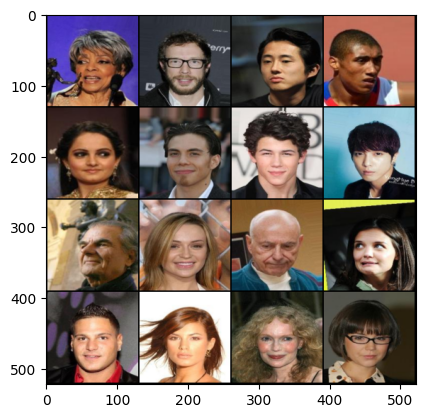

In [ ]:
## DataLoader
dataloader = DataLoader(ds, BATCH_SIZE, True)

## Models
generator = Generator(z_dim= z_dim, d_dim= 512, batch_size= BATCH_SIZE).to(device)
critic = Critic(3, hidden_units= 16).to(device)

## Optimizers
generator_optimizer = torch.optim.Adam(generator.parameters(), lr= LR, betas= (0.5, 0.9))
critic_optimizer = torch.optim.Adam(critic.parameters(), lr= LR, betas= (0.5, 0.9))

X, y = next(iter(dataloader))
show(X)

## Gradient Penalty

In [ ]:
def get_gp(real, fake, critic, alpha, gamma= 10):
    mix_images = real * alpha + (1 - alpha) * fake # Linear interpolation (blending the real and fake images) -> [32, 3, 128, 128]
    mix_scores = critic(mix_images) # [32, 1]

    # Calculates the sum of gradients of outputs with respect to the inputs
    gradient = torch.autograd.grad(
        inputs= mix_images,
        outputs= mix_scores,
        grad_outputs= torch.ones_like(mix_scores),
        retain_graph= True,
        create_graph= True
    )[0]

    gradient = gradient.view(len(gradient), -1)
    gradient_norm = gradient.norm(2, dim= 1) # For L2 regularisation

    gradient_penalty = gamma * ((gradient_norm - 1) ** 2).mean()

    return gradient_penalty

## Save and load checkpoints

In [ ]:
root_path = 'data/'
def save_checkpoint(name, gen, critic, gen_optim, critic_optim):
    torch.save({
        'epoch' : epoch,
        'model_state_dict' : gen.state_dict(),
        'optimizer_state_dict' : gen_optim.state_dict()
    }, f"{root_path}G-{name}.pkl")

    torch.save({
        'epoch' : epoch,
        'model_state_dict' : critic.state_dict(),
        'optimizer_state_dict' : critic_optim.state_dict()
    }, f"{root_path}C-{name}.pkl")

    print("Saved Checkpoint")

In [ ]:
def load_checkpoint(name):
    checkpoint = torch.load(f"{root_path}G-{name}.pkl")
    generator.load_state_dict(checkpoint['model_state_dict'])
    generator_optimizer.load_state_dict(checkpoint['optimizer_state_dict'])

    checkpoint = torch.load(f"{root_path}C-{name}.pkl")
    critic.load_state_dict(checkpoint['model_state_dict'])
    critic_optimizer.load_state_dict(checkpoint['optimizer_state_dict'])

    print("Checkpoint loaded")


Epoch: 0 and batch: 30
Generator loss: 10.60341386795044
Critic loss: -6.154947768052419


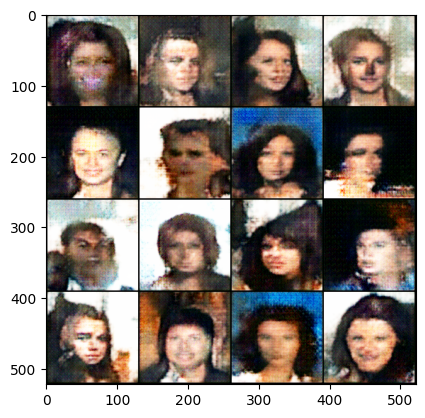

Saved Checkpoint

Epoch: 0 and batch: 60
Generator loss: 10.475873343149821
Critic loss: -6.476169463793435


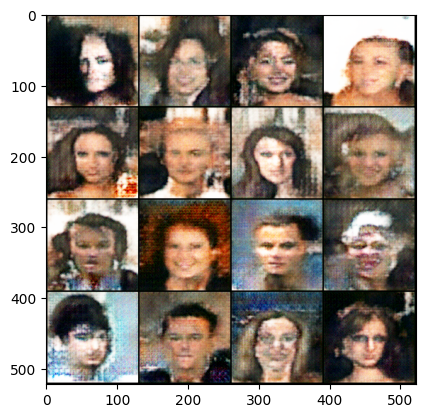

Saved Checkpoint

Epoch: 0 and batch: 90
Generator loss: 9.555515138308207
Critic loss: -6.410761540730795


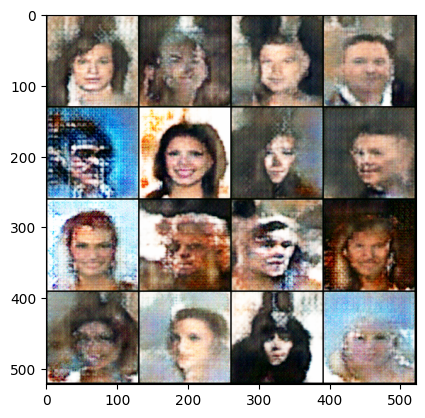

Saved Checkpoint

Epoch: 0 and batch: 120
Generator loss: 10.503412501017253
Critic loss: -6.271427709261577


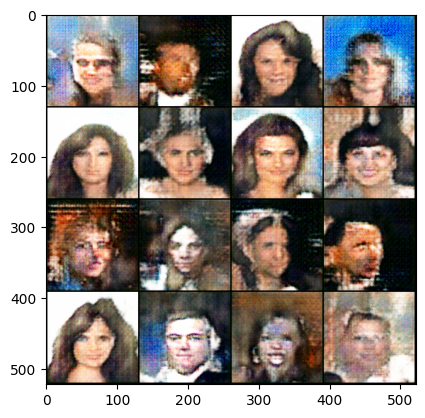

Saved Checkpoint

Epoch: 0 and batch: 150
Generator loss: 9.238672788937887
Critic loss: -6.2268926421801245


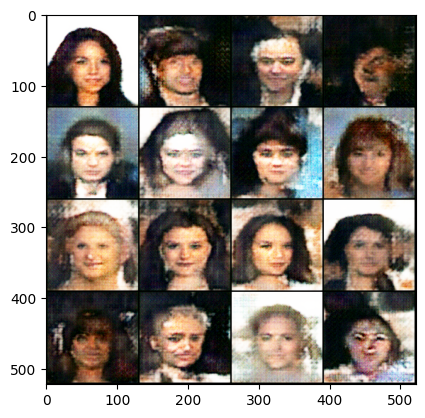

Saved Checkpoint

Epoch: 0 and batch: 180
Generator loss: 11.20824848016103
Critic loss: -6.021020596822103


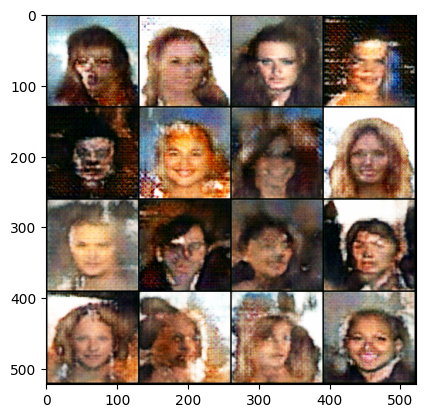


Epoch: 1 and batch: 30
Generator loss: 10.548347234725952
Critic loss: -6.29807597319285


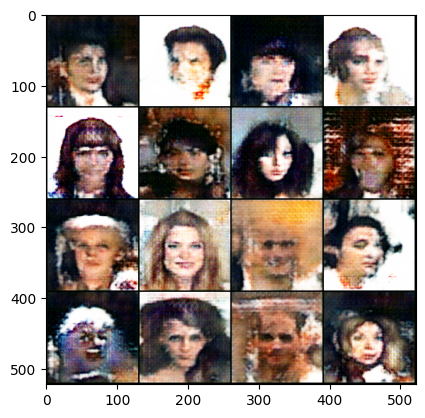

Saved Checkpoint

Epoch: 1 and batch: 60
Generator loss: 10.988714663187663
Critic loss: -6.054581775665283


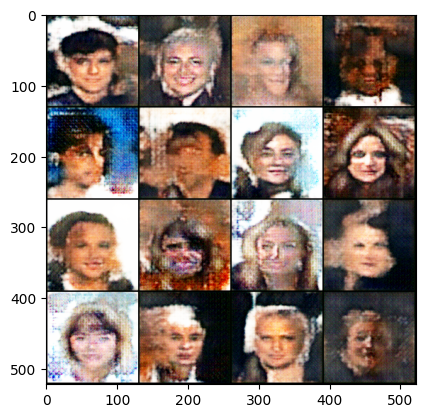

Saved Checkpoint

Epoch: 1 and batch: 90
Generator loss: 10.673621145884196
Critic loss: -6.286835643450419


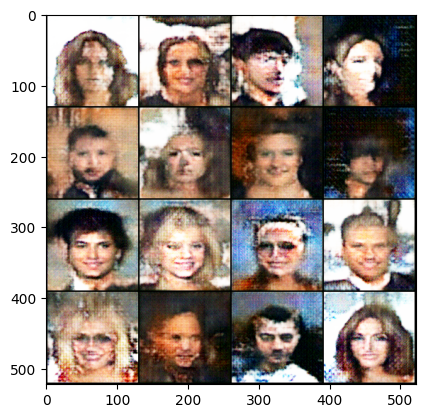

Saved Checkpoint

Epoch: 1 and batch: 120
Generator loss: 9.615604670842488
Critic loss: -6.14187314192454


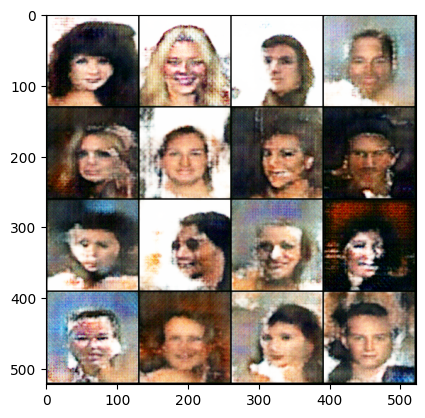

Saved Checkpoint

Epoch: 1 and batch: 150
Generator loss: 9.81525109608968
Critic loss: -6.055764684677125


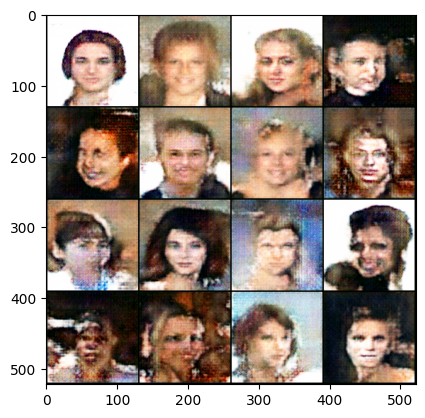

Saved Checkpoint

Epoch: 1 and batch: 180
Generator loss: 9.841722520192464
Critic loss: -5.8103726545969625


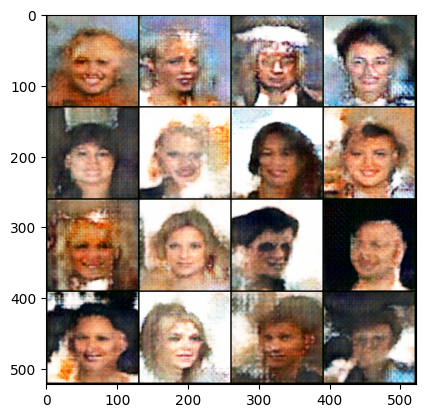


Epoch: 2 and batch: 30
Generator loss: 9.932804568608601
Critic loss: -6.144415300687154


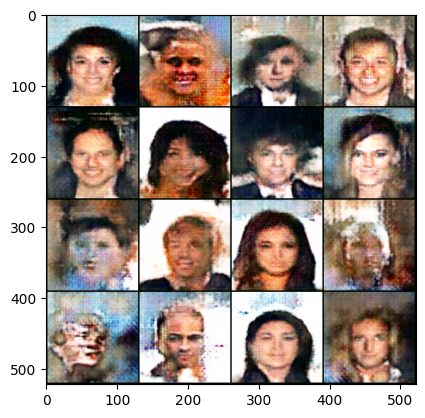

Saved Checkpoint

Epoch: 2 and batch: 60
Generator loss: 10.356816351413727
Critic loss: -6.16589932600657


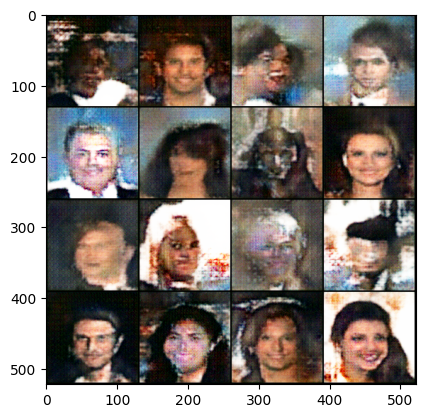

Saved Checkpoint

Epoch: 2 and batch: 90
Generator loss: 9.632484277089437
Critic loss: -6.157925252914427


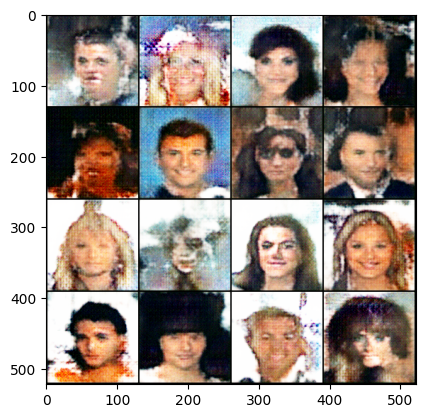

Saved Checkpoint

Epoch: 2 and batch: 120
Generator loss: 10.197564427057902
Critic loss: -6.010962600708008


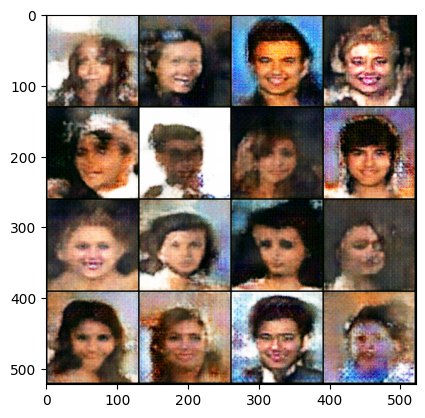

Saved Checkpoint

Epoch: 2 and batch: 150
Generator loss: 10.504824892679851
Critic loss: -5.741109404563904


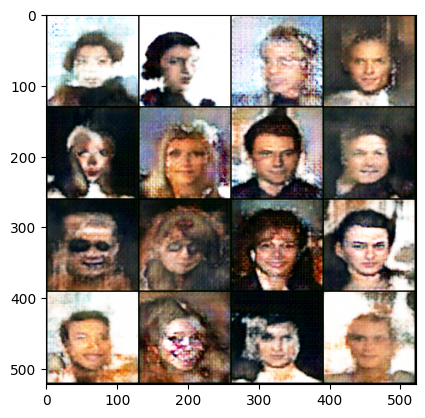

Saved Checkpoint

Epoch: 2 and batch: 180
Generator loss: 10.505431938171387
Critic loss: -5.892995468775433


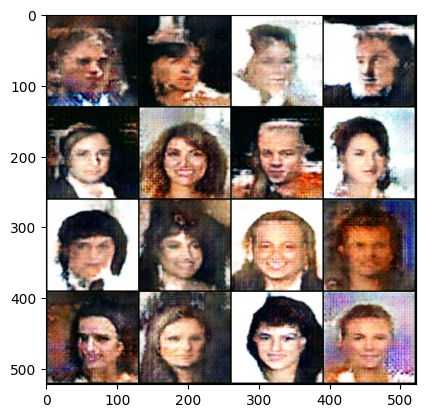


Epoch: 3 and batch: 30
Generator loss: 9.455819233258564
Critic loss: -6.20517473300298


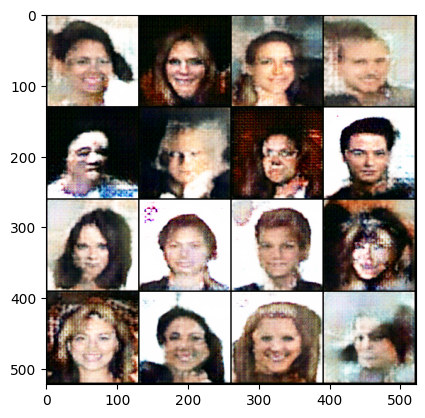

Saved Checkpoint

Epoch: 3 and batch: 60
Generator loss: 9.642910401026407
Critic loss: -5.885857323010762


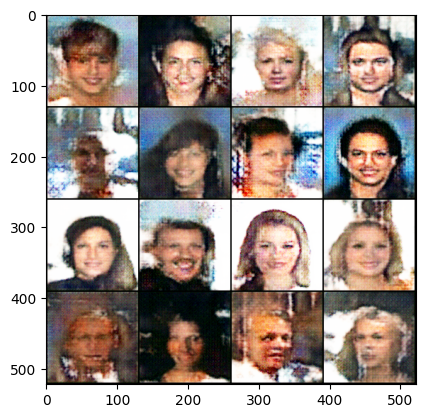

Saved Checkpoint

Epoch: 3 and batch: 90
Generator loss: 9.17316525777181
Critic loss: -6.030660963853199


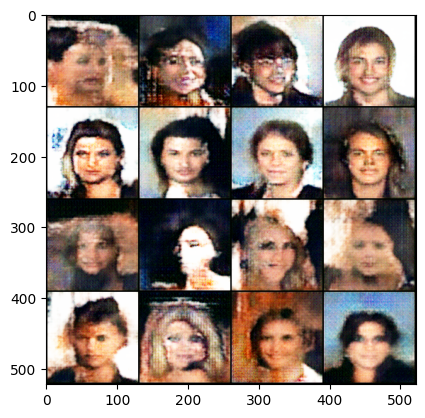

Saved Checkpoint

Epoch: 3 and batch: 120
Generator loss: 9.655273143450419
Critic loss: -5.970122575759888


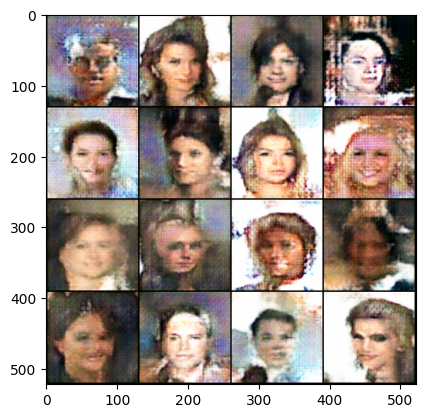

Saved Checkpoint

Epoch: 3 and batch: 150
Generator loss: 9.885953664779663
Critic loss: -5.9005300378799435


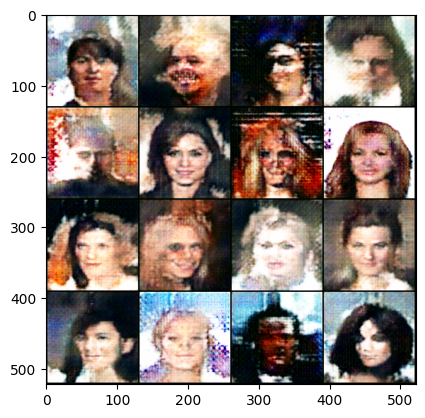

Saved Checkpoint

Epoch: 3 and batch: 180
Generator loss: 9.054533942540486
Critic loss: -5.6689424371719355


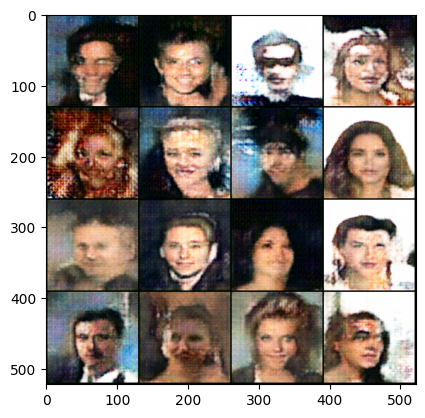


Epoch: 4 and batch: 30
Generator loss: 10.287981443603833
Critic loss: -6.15264772574107


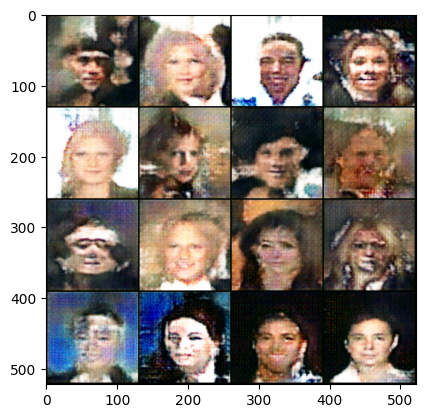

Saved Checkpoint

Epoch: 4 and batch: 60
Generator loss: 9.421400388081869
Critic loss: -5.955391449928284


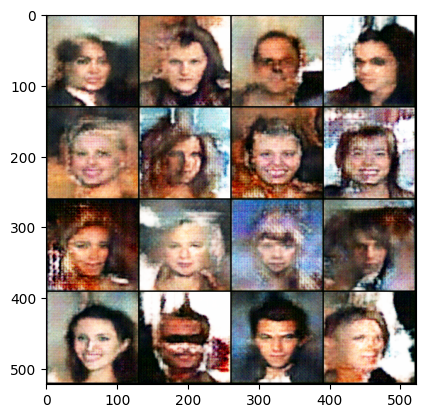

Saved Checkpoint

Epoch: 4 and batch: 90
Generator loss: 8.880872909228007
Critic loss: -5.731156143347423


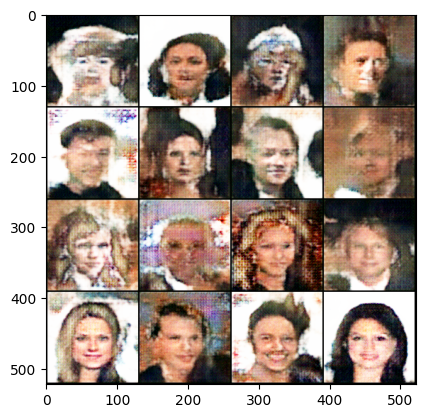

Saved Checkpoint

Epoch: 4 and batch: 120
Generator loss: 9.150396462281545
Critic loss: -5.710873730182649


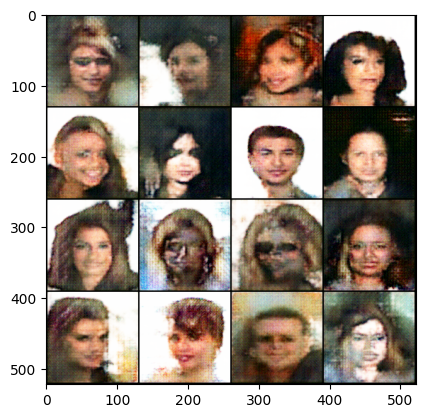

Saved Checkpoint

Epoch: 4 and batch: 150
Generator loss: 9.98397467136383
Critic loss: -5.650781302452086


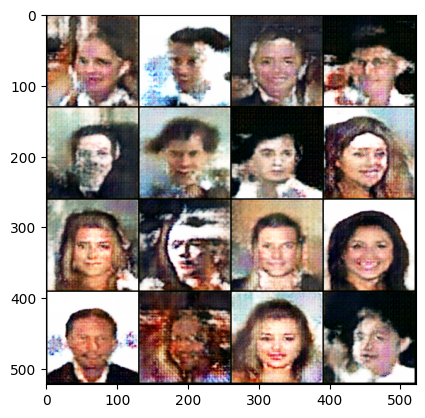

Saved Checkpoint

Epoch: 4 and batch: 180
Generator loss: 10.069827858606974
Critic loss: -5.409018594423929


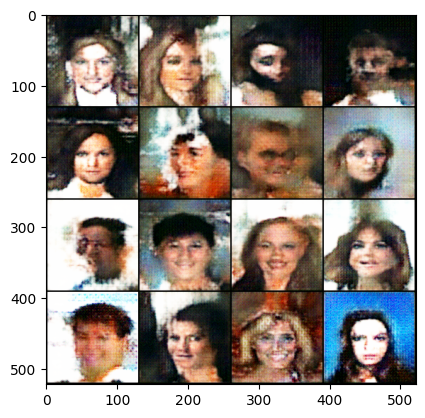


Epoch: 5 and batch: 30
Generator loss: 9.715134819348654
Critic loss: -6.015106182893118


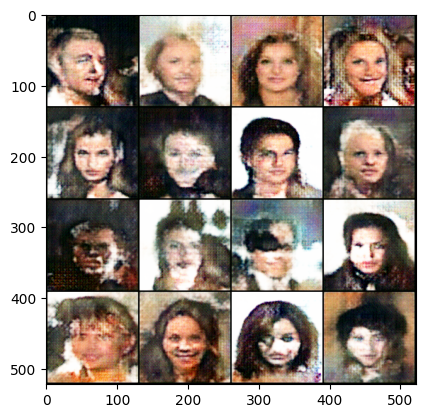

Saved Checkpoint

Epoch: 5 and batch: 60
Generator loss: 10.022186080614725
Critic loss: -5.8074262889226285


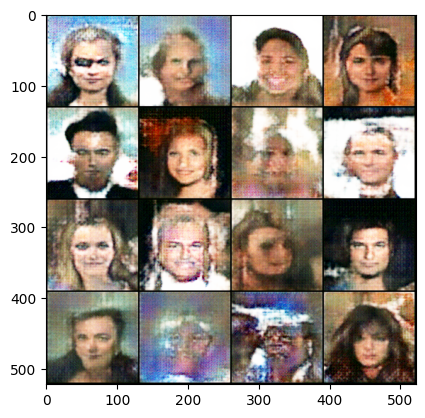

Saved Checkpoint

Epoch: 5 and batch: 90
Generator loss: 8.744764018058778
Critic loss: -5.868919626871744


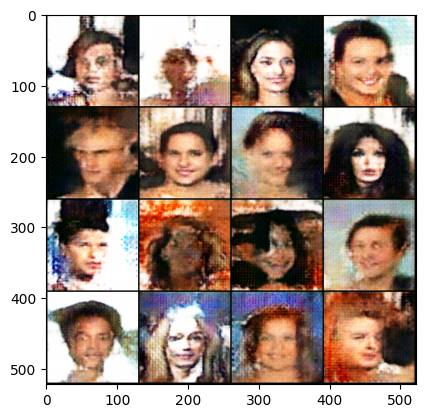

Saved Checkpoint

Epoch: 5 and batch: 120
Generator loss: 9.882780520121257
Critic loss: -5.493688813845315


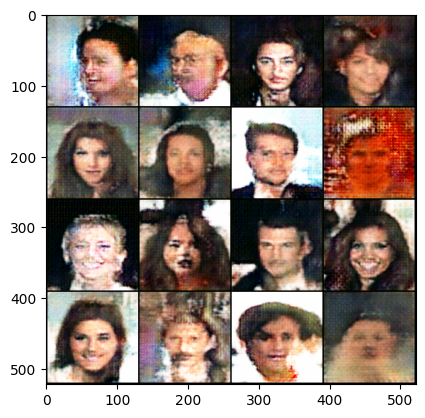

Saved Checkpoint

Epoch: 5 and batch: 150
Generator loss: 10.135291242599488
Critic loss: -5.723939492702483


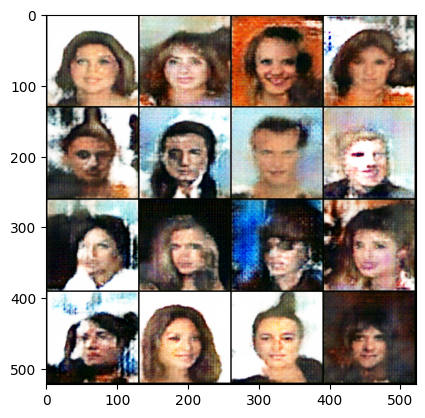

Saved Checkpoint

Epoch: 5 and batch: 180
Generator loss: 9.399903690814972
Critic loss: -5.4498603924115505


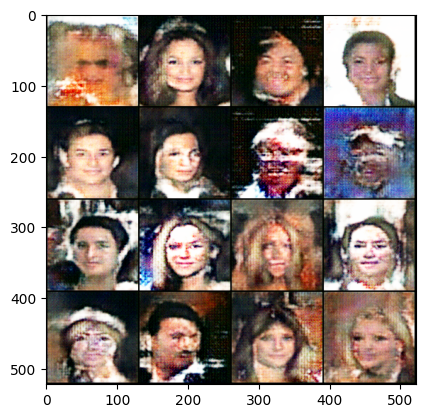


Epoch: 6 and batch: 30
Generator loss: 9.25663382212321
Critic loss: -5.7832587734858185


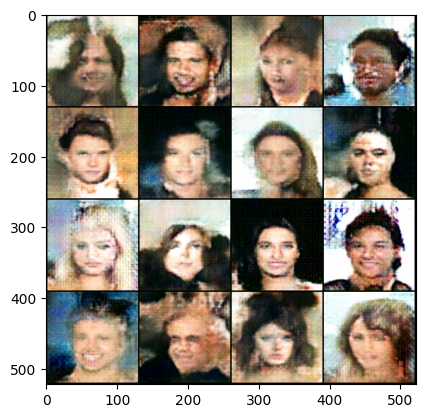

Saved Checkpoint

Epoch: 6 and batch: 60
Generator loss: 8.715263017018636
Critic loss: -5.656190033753714


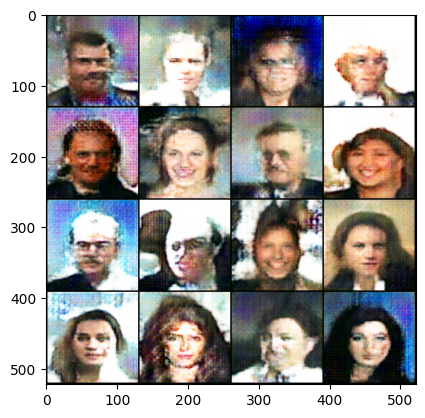

Saved Checkpoint

Epoch: 6 and batch: 90
Generator loss: 8.900977897644044
Critic loss: -5.757115370432536


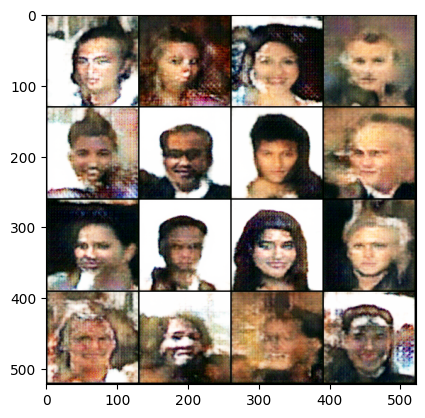

Saved Checkpoint

Epoch: 6 and batch: 120
Generator loss: 8.258703096707661
Critic loss: -5.404783246517182


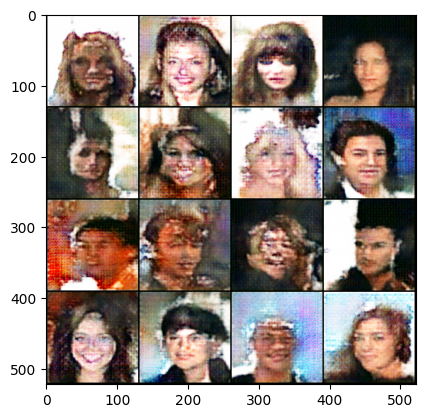

Saved Checkpoint

Epoch: 6 and batch: 150
Generator loss: 9.289649216334025
Critic loss: -5.743652091026306


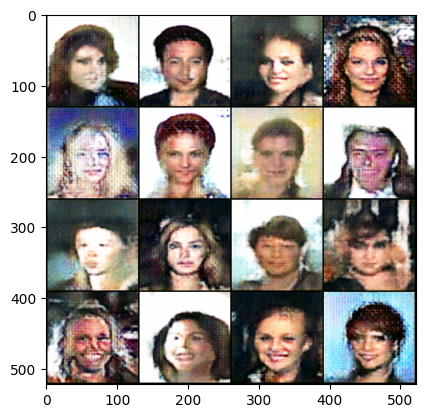

Saved Checkpoint

Epoch: 6 and batch: 180
Generator loss: 9.240355265140533
Critic loss: -5.344306594530741


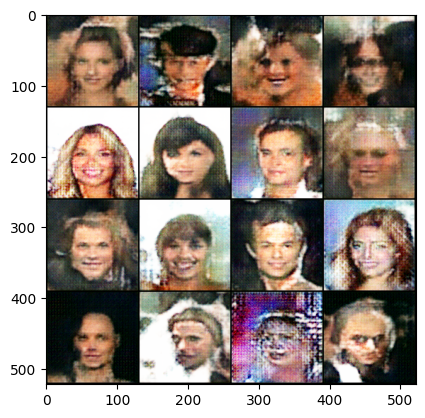


Epoch: 7 and batch: 30
Generator loss: 9.717716455459595
Critic loss: -5.904036626021066


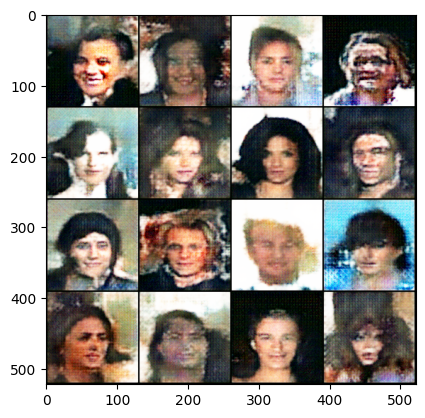

Saved Checkpoint

Epoch: 7 and batch: 60
Generator loss: 8.458982721964519
Critic loss: -5.668264050483704


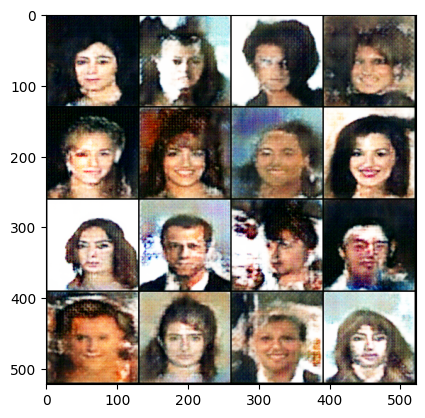

Saved Checkpoint

Epoch: 7 and batch: 90
Generator loss: 9.126503292719523
Critic loss: -5.555901532173156


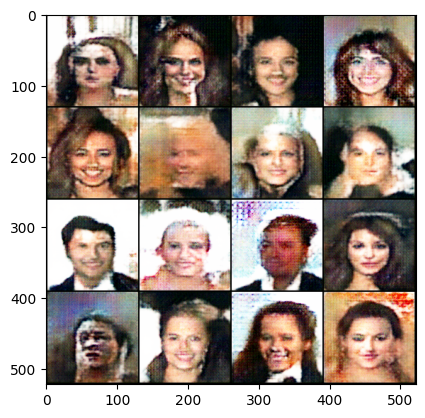

Saved Checkpoint

Epoch: 7 and batch: 120
Generator loss: 9.69881443977356
Critic loss: -5.475191373825074


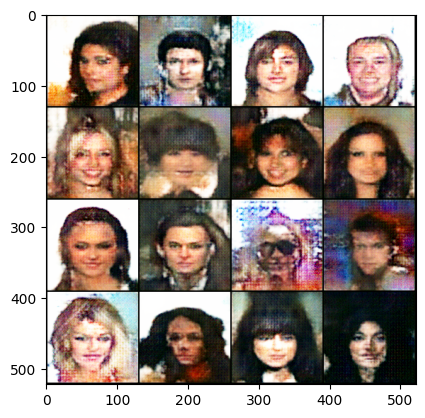

Saved Checkpoint

Epoch: 7 and batch: 150
Generator loss: 8.899558746814728
Critic loss: -5.508112893899283


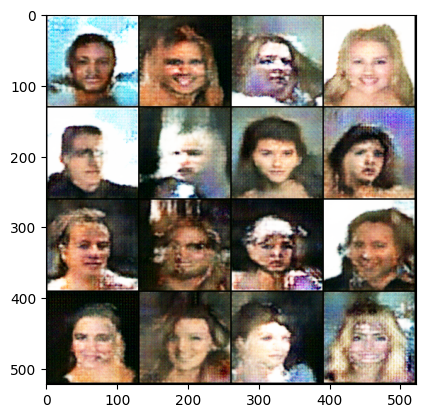

Saved Checkpoint

Epoch: 7 and batch: 180
Generator loss: 9.170565589269001
Critic loss: -5.54595290740331


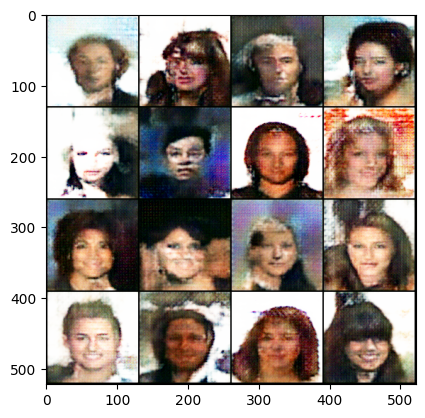


Epoch: 8 and batch: 30
Generator loss: 8.204854766527811
Critic loss: -6.064383440017699


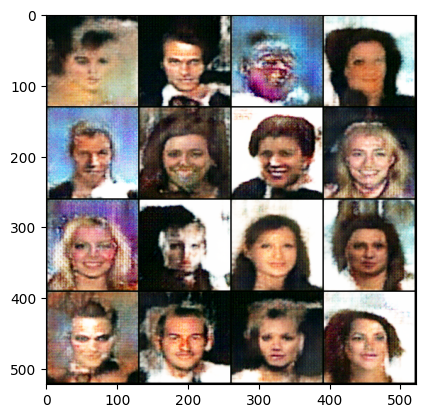

Saved Checkpoint

Epoch: 8 and batch: 60
Generator loss: 8.876578028996786
Critic loss: -5.568816120624544


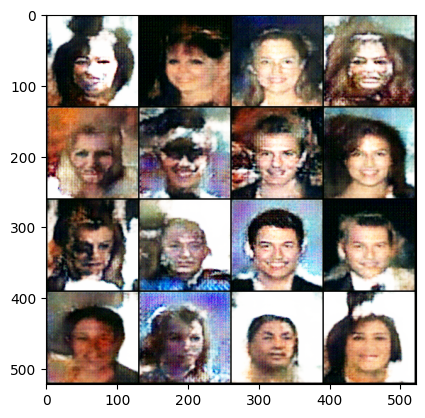

Saved Checkpoint

Epoch: 8 and batch: 90
Generator loss: 9.777216529846191
Critic loss: -5.709452918370565


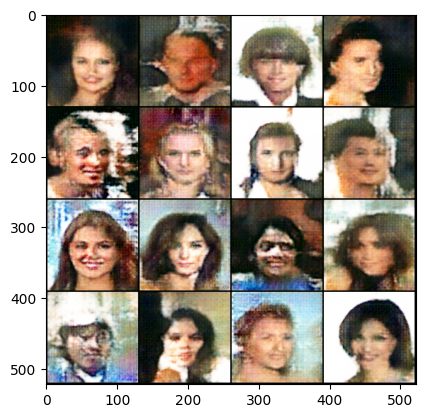

Saved Checkpoint

Epoch: 8 and batch: 120
Generator loss: 8.691942501068116
Critic loss: -5.613834185600281


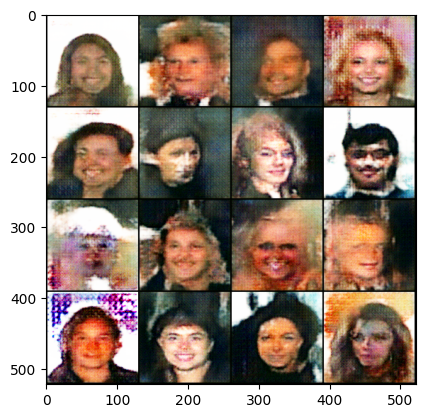

Saved Checkpoint

Epoch: 8 and batch: 150
Generator loss: 8.563119133313497
Critic loss: -5.457670918305714


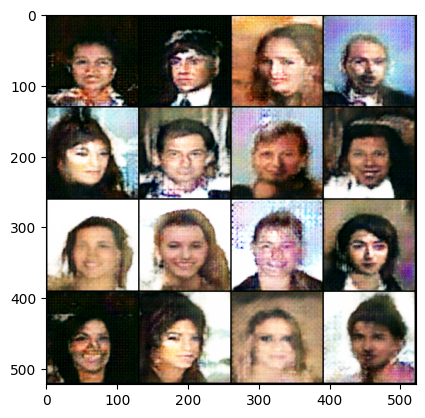

Saved Checkpoint

Epoch: 8 and batch: 180
Generator loss: 8.529541659355164
Critic loss: -5.3540250929196676


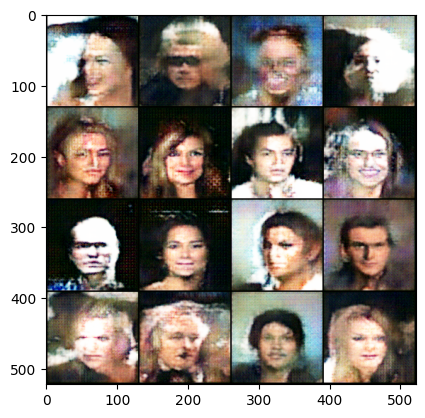


Epoch: 9 and batch: 30
Generator loss: 8.15709711710612
Critic loss: -5.9366540137926735


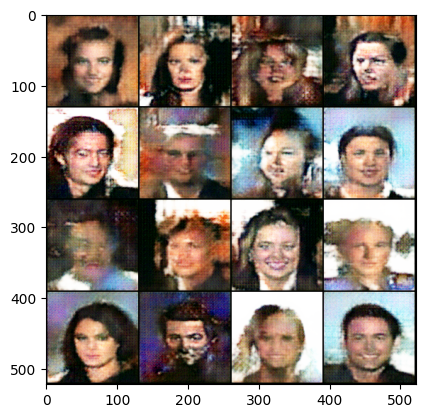

Saved Checkpoint

Epoch: 9 and batch: 60
Generator loss: 8.395288443565368
Critic loss: -5.548753056526183


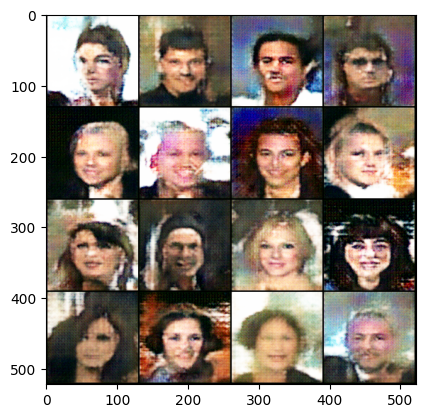

Saved Checkpoint

Epoch: 9 and batch: 90
Generator loss: 8.138788398106893
Critic loss: -5.373273609479267


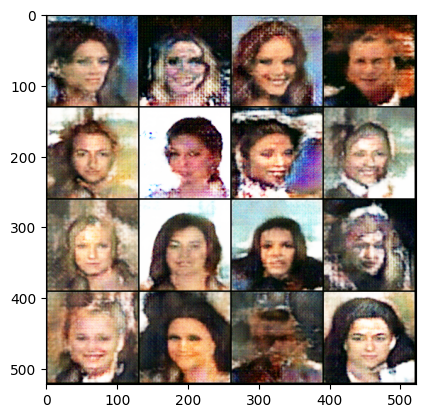

Saved Checkpoint

Epoch: 9 and batch: 120
Generator loss: 9.490604686737061
Critic loss: -5.4968973906834915


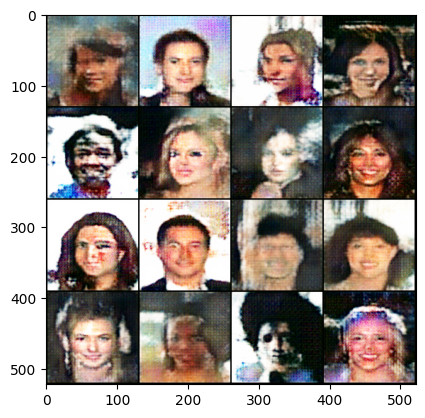

Saved Checkpoint

Epoch: 9 and batch: 150
Generator loss: 8.366244506835937
Critic loss: -5.319196323553721


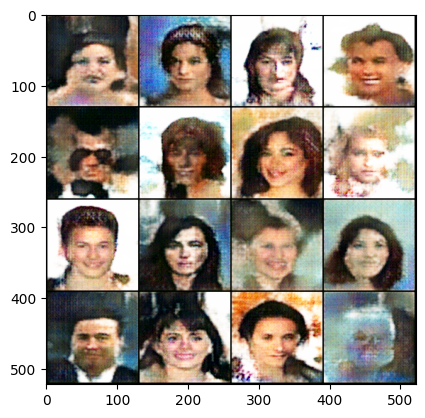

Saved Checkpoint

Epoch: 9 and batch: 180
Generator loss: 8.292722821235657
Critic loss: -5.39115497668584


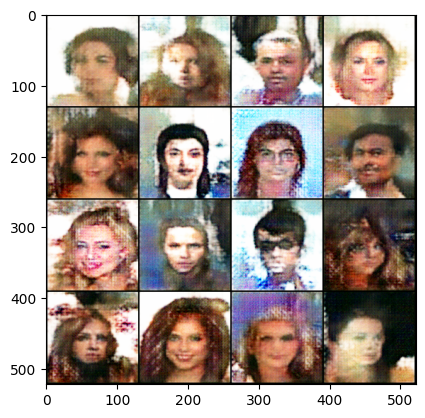

In [ ]:
## Training loop

for epoch in range(epochs):
    for batch, (real, labels) in enumerate(dataloader):
        current_batch_size = len(real) # 32
        real = real.to(device)
        ### Critic
        mean_critic_loss = 0
        for _ in range(crit_cycle):
            critic_optimizer.zero_grad()

            noise = gen_noise(current_batch_size)
            fake = generator(noise)
            critic_fake_pred = critic(fake.detach()) # .detach() so we don't update the parameters of generator
            critic_real_pred = critic(real)

            alpha = torch.rand(len(real), 1, 1, 1, device= device, requires_grad= True)  # Random alpha values of [32, 1, 1, 1]
            gradient_penalty = get_gp(real, fake.detach(), critic, alpha)

            critic_loss = critic_fake_pred.mean() - critic_real_pred.mean() + gradient_penalty
            mean_critic_loss += critic_loss.item() / crit_cycle

            critic_loss.backward()
            critic_optimizer.step()
        crit_losses.append(mean_critic_loss)

        ### Generator|
        generator_optimizer.zero_grad()
        noise = gen_noise(current_batch_size)
        fake = generator(noise)
        critic_pred = critic(fake)

        generator_loss = -critic_pred.mean()
        generator_loss.backward()
        generator_optimizer.step()

        gen_losses.append(generator_loss.item())

        ## Stats
        if (batch + 1) % save_step == 0:
            save_checkpoint('latest', generator, critic, generator_optimizer, critic_optimizer)


        if (batch + 1) % 30 == 0:
            print(f"\nEpoch: {epoch} and batch: {batch + 1}")

            gen_mean = sum(gen_losses[-30:]) / 30
            critic_mean = sum(crit_losses[-30:]) / 30

            print(f"Generator loss: {gen_mean}")
            print(f"Critic loss: {critic_mean}")
            show(fake, name= 'fake')

In [ ]:
gen_losses

NameError: ignored

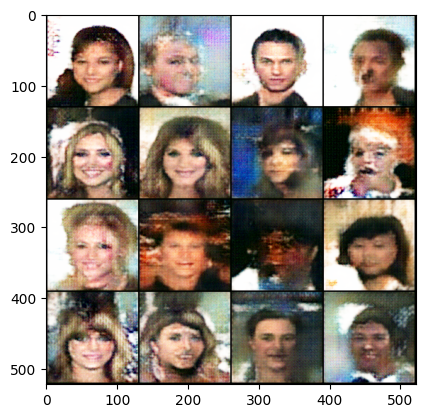

In [ ]:
# Generate new faces
noise = gen_noise(BATCH_SIZE)
fake = generator(noise)
show(fake)

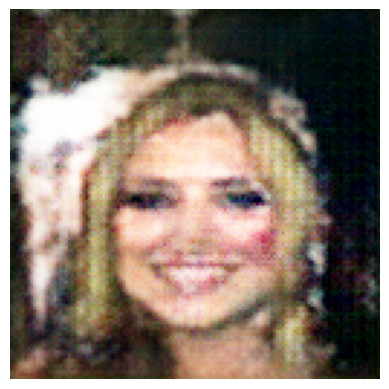

In [ ]:
plt.imshow(fake[4].detach().cpu().permute(1, 2, 0).squeeze().clip(0, 1))
plt.axis(False);

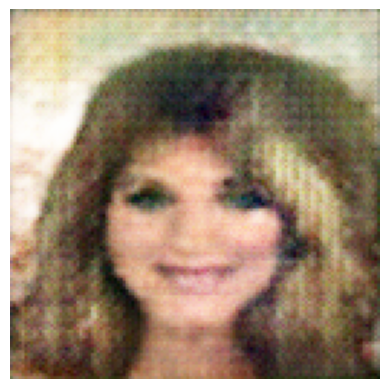

In [ ]:
plt.imshow(fake[5].detach().cpu().permute(1, 2, 0).squeeze().clip(0, 1))
plt.axis(False);

## Morphing
* Interpolation between points in latent space

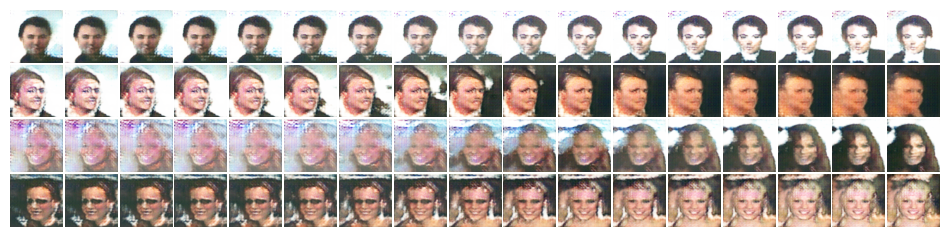

In [ ]:
from mpl_toolkits.axes_grid1 import ImageGrid
gen_set = []
z_shape = [BATCH_SIZE, z_dim]
rows = 4
steps = 17

for i in range(rows):
    z1, z2 = torch.randn(z_shape), torch.randn(z_shape)

    for alpha in np.linspace(0, 1, steps):
        z = alpha * z1 + (1 - alpha) * z2

        result = generator(z.cuda())
        gen_set.append(result)

fig = plt.figure(figsize= (12, 9))
grid = ImageGrid(fig, 111, nrows_ncols= (rows, steps))

for ax, img in zip(grid, gen_set):
    ax.axis("off")
    img = img[0]
    res = img.cpu().detach().permute(1, 2, 0)
    res = res - res.min()
    res /= res.max() - res.min()
    ax.imshow(res)

plt.show()